In [2]:
from dendrocat import RadioSource, MasterCatalog
from astropy.io import fits
from spectral_cube import SpectralCube
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import numpy as np
import sys
import importlib
from astropy.wcs import WCS
from regions import Regions, PixCoord
from astropy import stats
from itertools import chain
import dendrocat
from scipy import stats
import Paths.Paths as paths
Path = paths.filepaths()









/home/t.yoo/anaconda3/lib/python3.9/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.26.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [16]:
from astropy.nddata.utils import Cutout2D, NoOverlapError
from astropy import coordinates, wcs
import astropy.units as u
from matplotlib import colors
from matplotlib.patches import Rectangle, Ellipse
from radio_beam import Beam
import matplotlib.patches as patches
from matplotlib.gridspec import GridSpec

def get_cutout(image_dir, xpos, ypos, fwhm):
    fitsdata = fits.open(image_dir)
    wcs_image = WCS(fitsdata[0].header,naxis=2)
    image = fitsdata[0].data[0][0]
    if len(image.shape)>2:
        image = fitsdata[0].data[0][0]
    x_cen = xpos * u.deg
    y_cen = ypos * u.deg
    position = coordinates.SkyCoord(x_cen, y_cen,
                                    frame=wcs.utils.wcs_to_celestial_frame(wcs_image).name,
                                    unit=(u.deg, u.deg))
    pixel_scale = (np.abs(wcs_image.pixel_scale_matrix.diagonal().prod())**0.5 * u.deg)
    size = 10*fwhm
        #size = 24*pixel_scale + 2.5*fwhm * u.deg
    
    cutout = Cutout2D(image,
                          position,
                      size,
                      wcs=wcs_image,
                      mode='partial')
     

  
    return cutout

def add_scale_bar(ax, xpos,ypos,scale, pixel_scale, dist, unit='pc',height=20,color='w',pad=40,size=40):
    phy_pix_scale = pixel_scale.value * np.pi/180 * dist
    ax.add_patch(Rectangle((xpos,ypos),scale/phy_pix_scale,height,color=color))
    ax.text(xpos+0.4*scale/phy_pix_scale, ypos+pad, '%2.1f %s'%(scale, unit), color=color,fontsize=size)
                
def add_beam(ax,xpos,ypos,beam, pixel_scale,color='w'):
    width = beam.major / pixel_scale
    height = beam.minor /pixel_scale
    angle = beam.pa
    ax.add_patch(Ellipse((xpos,ypos),width.value,height.value,180-angle.value,color=color))

def plot_cutouts(ax, image_dir, xpos, ypos, fwhm, cmap='inferno', 
                 addbeam=True, scale=None, dist=None, 
                 vmin=-0.00010907209521789237, vmax=0.01065474459299, sqrtpower=True,
                label=None, mmlabel=None, nomatch=False,fontcolor='w',
                ):
    
    cutout = get_cutout(image_dir, xpos, ypos, fwhm)
    shape = cutout.data.shape
    hdr = fits.getheader(image_dir)  
    wcs = WCS(hdr,naxis=2)
    pixel_scale = wcs.proj_plane_pixel_scales()[0]
    beam = Beam.from_fits_header(hdr)
    midpoint = int(shape[0]/2)

    beamsize_pix = beam.major.to(u.deg).value / pixel_scale

    if sqrtpower:
        vmax = np.nanmax(cutout.data[midpoint-int(2*beamsize_pix.value):midpoint+int(2*beamsize_pix.value), midpoint-int(2*beamsize_pix.value):midpoint+int(2*beamsize_pix.value)])
        ax.imshow(cutout.data, origin='lower', cmap=plt.get_cmap(cmap), 
              norm=colors.PowerNorm(gamma=0.5, vmin=np.min(cutout.data[np.isfinite(cutout.data)]), 
                                    vmax=1.5*vmax),aspect='equal')
    else:
        
        ax.imshow(cutout.data, origin='lower', cmap=plt.get_cmap(cmap), 
              vmin=vmin, vmax=vmax,aspect='auto')
    if addbeam:
        add_beam(ax, 0.15*shape[0], 0.15*shape[1], beam, pixel_scale)
    if scale is not None:
        add_scale_bar(ax, 0.8*shape[0], 0.2*shape[1], scale, pixel_scale, dist)
    if label is not None:
        ax.text(0.08*shape[0],0.85*shape[1], label, color=fontcolor, fontsize=35)
   
        
    #if mmlabel is not None:
    #    ax.text(0.65*shape[0],0.85*shape[1], mmlabel, color=mmlabelcolor, fontsize=25)
    ax.set_xticks([])
    ax.set_yticks([])
    return cutout.data


def plot_set_cutouts(table_fin, b3file, b6file, savedir='', 
startnum=0,  nrow=9, ncol=4, margin = 0.01, top = 0.98, bottom = 0.02,
wspace=0.00, hspace=0.00, additional_row=0, endnum=None):
    
    hdr_b3 = fits.getheader(b3file)
    hdr_b6 = fits.getheader(b6file)

    beam_b3 = Beam.from_fits_header(hdr_b3)    
    beam_b6 = Beam.from_fits_header(hdr_b6)
    size = (beam_b3.major+beam_b6.major)/2   

    if endnum is None:
        endnum = len(table_fin['b3_xsky'])
    endendnum = len(table_fin['b3_xsky'])
    print('endnum', endnum)
    print('endendnum', endendnum)
    width = (1 - margin*ncol)/ncol
    height = (top-bottom-5*margin)/(nrow+additional_row)
    ratio = width/2/height
    bottom = top - height * nrow
    figsize=40
    fig = plt.figure(figsize=(figsize,figsize*ratio))
    if nrow >0:
        for icol in range(ncol):
            gs = GridSpec(nrow, 2, left=(icol+1)*margin+icol*width, right=(icol+1)*(margin+width), 
                        wspace=wspace, hspace=hspace, top=top, bottom=bottom)
            for irow in range(nrow):
                obsnum = icol * nrow + irow + startnum
                print('obsnum',obsnum)
                if obsnum > endnum:
                    continue
                obsnum_final = obsnum
                ax1 = fig.add_subplot(gs[irow,0])
                ax2 = fig.add_subplot(gs[irow,1])
                ax1.set_aspect('auto')
                ax2.set_aspect('auto')
                ax1.xaxis.set_major_locator(plt.NullLocator())
                ax1.yaxis.set_major_locator(plt.NullLocator())
                ax2.xaxis.set_major_locator(plt.NullLocator())
                ax2.yaxis.set_major_locator(plt.NullLocator())

                if irow == 0:
                    ax1.set_title('3 mm', fontsize=40)
                    ax2.set_title('1.3 mm', fontsize=40)

                xpos_b3 = table_fin['b3_xsky'][obsnum]
                ypos_b3 = table_fin['b3_ysky'][obsnum]
                #fwhm_b3 = table_fin['b3_afwhm'][obsnum]
                
                xpos_b6 = table_fin['b6_xsky'][obsnum]
                ypos_b6 = table_fin['b6_ysky'][obsnum]
                #fwhm_b6 = table_fin['b6_afwhm'][obsnum]
                
                isoverlap = table_fin['is_overlap'][obsnum]
                
                b3id = table_fin['b3_id'][obsnum]
                b6id = table_fin['b6_id'][obsnum]
                b3continue=True ; b6continue=True
                nomatch_b3 = False ; nomatch_b6 = False
                print(obsnum, xpos_b3, ypos_b3, xpos_b6, ypos_b6, b3id, b6id)

                if not isoverlap: # if B3 positions are out of the FoV of B6, then just skip drawing
                    if xpos_b3 < 0 or ypos_b3 <0:
                        b3continue=False
                    if xpos_b6 < 0 or ypos_b6 <0:
                        b6continue=False
                else:
                    if xpos_b3 < 0 or ypos_b3 <0:
                        xpos_b3 = xpos_b6 ; ypos_b3 = ypos_b6
                        nomatch_b3=True
                    if xpos_b6 < 0 or ypos_b6 <0:
                        xpos_b6 = xpos_b3 ; ypos_b6 = ypos_b3
                        nomatch_b6=True
                if b3continue:
                    b3arr = plot_cutouts(ax1, b3file, xpos_b3, ypos_b3, size,label='#%d'%(obsnum), mmlabel='3 mm', nomatch=nomatch_b3)
                    
                if b6continue:
                    b6arr = plot_cutouts(ax2, b6file, xpos_b6, ypos_b6, size, mmlabel='1.3 mm',nomatch=nomatch_b6)
                if nomatch_b3:
                    rect = patches.Rectangle((0.02*b3arr.shape[1], 0.02*b3arr.shape[0]), 0.96*b3arr.shape[1], 0.96*b3arr.shape[0], linewidth=30, edgecolor='cyan', facecolor='none')
                    ax1.add_patch(rect)

                if nomatch_b6:
                    rect = patches.Rectangle((0.02*b6arr.shape[1], 0.02*b6arr.shape[0]), 0.96*b6arr.shape[1], 0.96*b6arr.shape[0], linewidth=30, edgecolor='cyan', facecolor='none')
                    ax2.add_patch(rect)
        print('obsnum_final, endnum',obsnum_final, endnum)
        print('endnum',endnum)   
    if additional_row > 0:
        top_add = bottom - 5*margin
        bottom_add = top_add - additional_row * height
        print('height',height)
        print('top_add', top_add)
        print('bottom_add', bottom_add)
        print('margin', margin)
        gs_add = GridSpec(additional_row, ncol*2, left=margin, right=1-margin,wspace=0.0, hspace=0.0, top=top_add, bottom=bottom_add)
        print('endnum', endnum)
        print('endendnum', endendnum)
        arr = np.arange(endnum+1, endendnum)
        print('arr', arr)
        for num in arr:
            ind = num - endnum - 1

            xind = ind % (ncol*2) 
            yind = ind // (ncol*2)
            print('ind, xind, yind', ind, xind, yind)
            ax = fig.add_subplot(gs_add[yind,xind])
            if ind==0:
                ax.set_title('3 mm', fontsize=40)
            #ax.set_aspect('auto')
            ax.xaxis.set_major_locator(plt.NullLocator())
            ax.yaxis.set_major_locator(plt.NullLocator())
            xpos_b3 = table_fin['b3_xsky'][num]
            ypos_b3 = table_fin['b3_ysky'][num]
            b3arr = plot_cutouts(ax, b3file, xpos_b3, ypos_b3, size,label='#%d'%(num), mmlabel='3 mm', nomatch=True)
                



    print('plot saved to ', savedir)
    plt.savefig(savedir)
    

             
def plot_set_cutouts_single(table_fin, b3file, b6file, savedir='', 
startnum=0,  nrow=9, ncol=4, margin = 0.01, top = 0.98, bottom = 0.02,
wspace=0.00, hspace=0.00, endnum=None, different_font_color_ind=[]):

    hdr_b3 = fits.getheader(b3file)
    hdr_b6 = fits.getheader(b6file)

    beam_b3 = Beam.from_fits_header(hdr_b3)    
    beam_b6 = Beam.from_fits_header(hdr_b6)

    if endnum is None:
        endnum = len(table_fin['b3_xsky'])

    width = (1 - margin*ncol)/ncol
    height = (top-bottom)/nrow
    ratio = width/height
    figsize=40
    fig = plt.figure(figsize=(figsize,figsize*ratio))

    gs = GridSpec(nrow, ncol, left=margin, right=1-margin, 
                    wspace=wspace, hspace=hspace, top=top, bottom=bottom)
    
    for irow in range(nrow):
        for icol in range(ncol):
            obsnum = irow * ncol + icol + startnum
            print('obsnum',obsnum)
            #print(obsnum, xpos_b3, ypos_b3,  b3id)


            ax1 = fig.add_subplot(gs[irow,icol])
            #ax2 = fig.add_subplot(gs[irow,icol])
            ax1.set_aspect('auto')
            #ax2.set_aspect('auto')

            ax1.xaxis.set_major_locator(plt.NullLocator())
            ax1.yaxis.set_major_locator(plt.NullLocator())

            if obsnum > endnum:
                continue

           
           


            if irow == 0 and icol == 0:
                ax1.set_title('3 mm', fontsize=40)
            #    ax2.set_title('1.3 mm', fontsize=40)

            xpos_b3 = table_fin['b3_xsky'][obsnum]
            ypos_b3 = table_fin['b3_ysky'][obsnum]
            #fwhm_b3 = table_fin['b3_afwhm'][obsnum]
            
            #xpos_b6 = table_fin['b6_xsky'][obsnum]
            #ypos_b6 = table_fin['b6_ysky'][obsnum]
            #fwhm_b6 = table_fin['b6_afwhm'][obsnum]
            
            isoverlap = table_fin['is_overlap'][obsnum]
            
            b3id = table_fin['b3_id'][obsnum]
            #b6id = table_fin['b6_id'][obsnum]
            b3continue=True ; b6continue=True
            nomatch_b3 = False ; nomatch_b6 = False

            if not isoverlap: # if B3 positions are out of the FoV of B6, then just skip drawing
                if xpos_b3 < 0 or ypos_b3 <0:
                    b3continue=False
            #      if xpos_b6 < 0 or ypos_b6 <0:
            #          b6continue=False
            else:
                if xpos_b3 < 0 or ypos_b3 <0:
                    xpos_b3 = xpos_b6 ; ypos_b3 = ypos_b6
                    nomatch_b3=True
            #      if xpos_b6 < 0 or ypos_b6 <0:
            #          xpos_b6 = xpos_b3 ; ypos_b6 = ypos_b3
            #          nomatch_b6=True
            size = (beam_b3.major+beam_b6.major)/2   
            if b3continue:
                if obsnum in different_font_color_ind:
                    fontcolor = 'k'
                else:
                    fontcolor = 'w'
                b3arr = plot_cutouts(ax1, b3file, xpos_b3, ypos_b3, size,label='#%d'%(obsnum), mmlabel='3 mm', nomatch=nomatch_b3, fontcolor=fontcolor)
                
            #if b6continue:
            #    b6arr = plot_cutouts(ax2, w51e_b6_calibrated_pbcor, xpos_b6, ypos_b6, size, mmlabel='1.3 mm',nomatch=nomatch_b6)
            if nomatch_b3:
                rect = patches.Rectangle((0.02*b3arr.shape[1], 0.02*b3arr.shape[0]), 0.96*b3arr.shape[1], 0.96*b3arr.shape[0], linewidth=30, edgecolor='cyan', facecolor='none')
                ax1.add_patch(rect)

            #if nomatch_b6:
            #    rect = patches.Rectangle((0.05*b6arr.shape[1], 0.05*b6arr.shape[1]), 0.9*b6arr.shape[1], 0.9*b6arr.shape[0], linewidth=30, edgecolor='r', facecolor='none')
            #    ax2.add_patch(rect)
    plt.savefig(savedir)       
    plt.show()     


125
obsnum 0
0 290.9323236580427 14.505409165819163 290.93232480562904 14.50541222136782 93030993 226003591
obsnum 1
1 290.9323698526286 14.505461665938908 290.932371860991 14.505463332600574 93031160 226003728
obsnum 2
2 290.9324542082429 14.505457777245084 290.932455642757 14.505459999460392 93031210 226003758
obsnum 3
3 290.9324642504769 14.50550249948864 290.9324648242179 14.505505555035423 93031450 226003857
obsnum 4
4 290.93224934308944 14.505939998942365 290.9322524991548 14.505941110052976 93033120 226004857
obsnum 5
5 290.932584757782 14.505932221933161 290.9325841838294 14.505934444144511 93033295 226004920
obsnum 6
6 290.93261086786623 14.50595749975086 290.93261287623363 14.505959999743824 93033484 226004956
obsnum 7
7 290.93127523365786 14.50606249401039 290.9312758073839 14.506065549560057 93034136 226005138
obsnum 8
8 290.9323598082871 14.506204443693052 290.93236152972986 14.506206665909666 93034470 226005314
obsnum 9
9 290.93248031666974 14.506218055078794 290.93248203

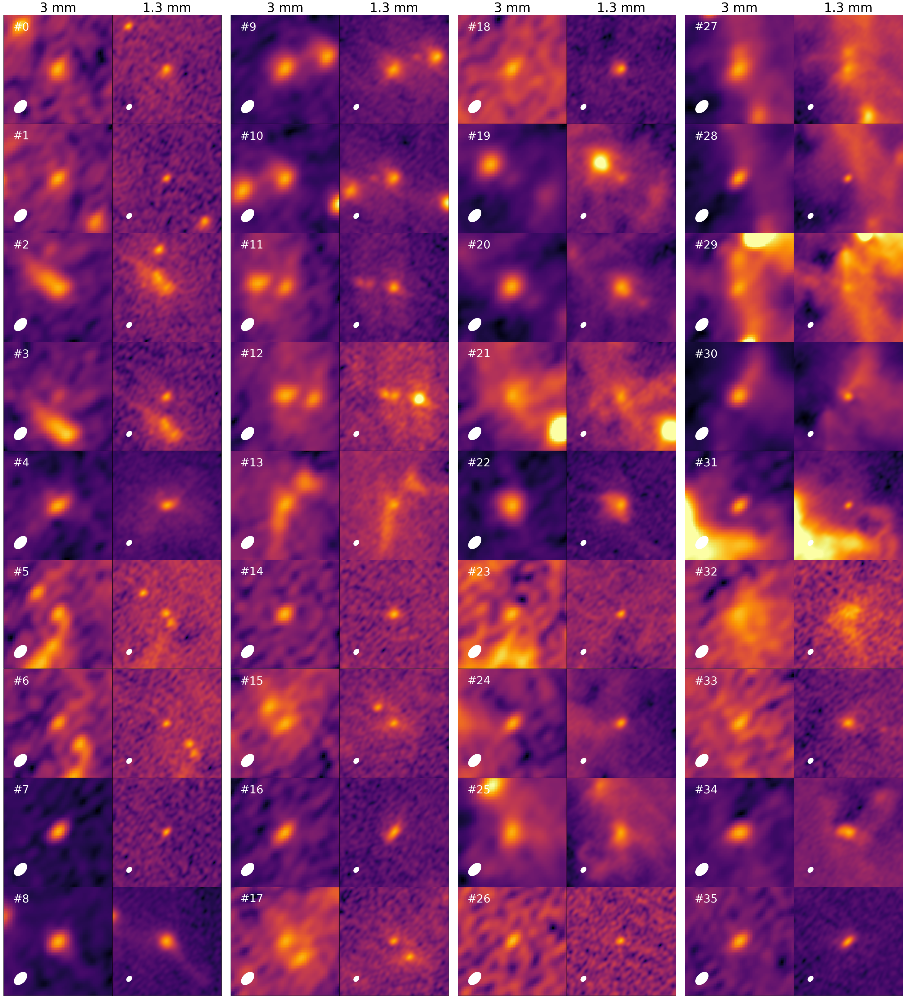

In [4]:
from astropy.table import Table
table_w51e = Table.read(Path.w51e_dendro_matched_catalog_new)
print(len(table_w51e))
    


plot_set_cutouts(table_w51e, Path.w51e_b3_tt0, Path.w51e_b6_tt0,nrow=9,savedir='w51e_snapshot-1.png')


obsnum 36
36 290.9331873028754 14.509581944342363 290.9331924675019 14.509583333216197 93043756 226008987
obsnum 37
37 290.93316119236573 14.50963055547734 290.9331637746304 14.509632222131787 93043890 226009053
obsnum 38
38 290.93242206256986 14.509671388289053 290.93242464482876 14.50967333272936 93044010 226009111
obsnum 39
39 290.93306880121185 14.509747222205275 290.9330719573353 14.509747777749356 93044158 226009175
obsnum 40
40 290.93330178795094 14.509799721981429 290.93330379635927 14.509801110857401 93044279 226009256
obsnum 41
41 290.9314338765924 14.509893050645397 290.931436458849 14.509894439540947 93044556 226009374
obsnum 42
42 290.931530284765 14.509918329025679 290.93153171929515 14.509921106802128 93044621 226009394
obsnum 43
43 290.93282175485734 14.510001944413862 290.9328217547551 14.510005555514972 93044761 226009445
obsnum 44
44 290.93118682943873 14.509992215588559 290.93118740318033 14.509994437805098 93044792 226009461
obsnum 45
45 290.9327795761929 14.509998

obsnum 51
51 290.9330547418288 14.510106944433668 290.93305359401074 14.5101099999797 93045082 226009592
obsnum 52
52 290.93291816321357 14.5101497222277 290.9329204585522 14.510153333329205 93045151 226009602
obsnum 53
53 290.9330587588643 14.510145833320882 290.9330593326255 14.510148888866212 93045129 226009614
obsnum 54
54 290.93300452912007 14.51017694444883 290.9330053898101 14.51017777777201 93045259 226009663
obsnum 55
55 290.932916154672 14.510318888894028 290.9329181630825 14.510321111106615 93045450 226009778
obsnum 56
56 290.93303264832645 14.51039277777499 290.9330340828781 14.510394444431228 93045705 226009866
obsnum 57
57 290.9324923587054 14.51040249954933 290.9324946540502 14.510401110654948 93045712 226009869
obsnum 58
58 290.9318074543848 14.510760274983188 290.931808315061 14.510763330532956 93046557 226010168
obsnum 59
59 290.9327193196277 14.51122694433264 290.93272075418093 14.51122999987963 93047672 226010516
obsnum 60
60 290.9295799999782 14.511508864740582 290

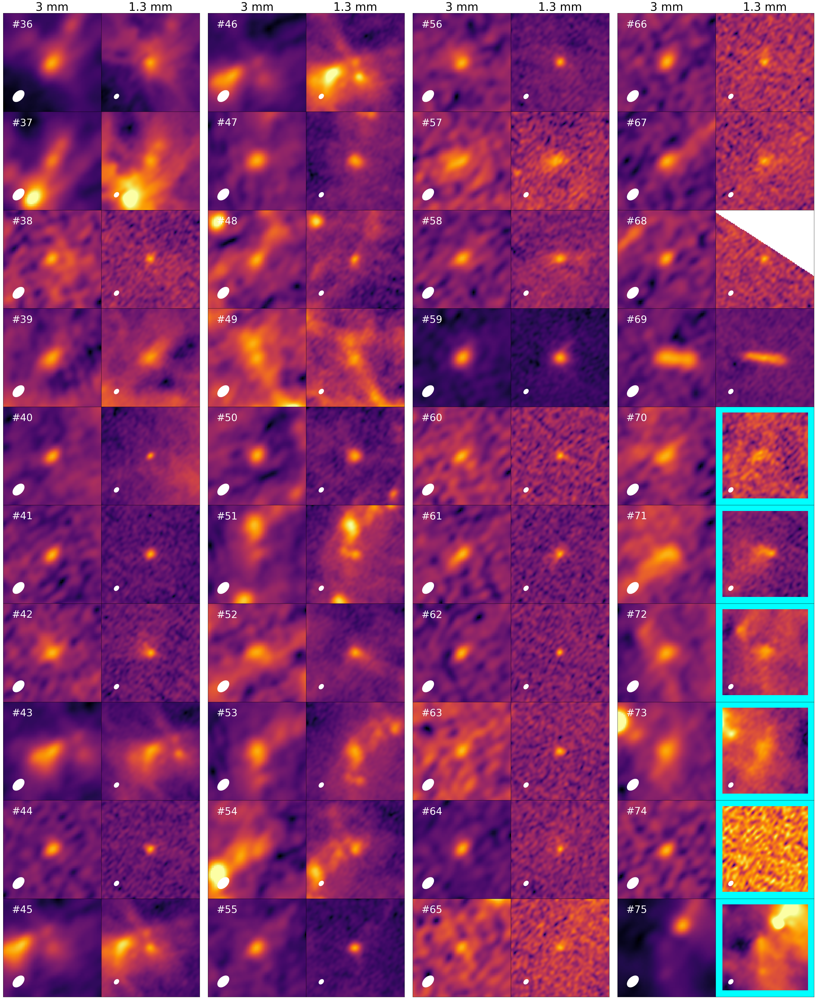

In [5]:
plot_set_cutouts(table_w51e, Path.w51e_b3_tt0,  Path.w51e_b6_tt0,startnum=36, nrow=10,savedir='w51e_snapshot-2.png')


endnum 113
endendnum 125
obsnum 76
76 290.93231360702663 14.5083919435734 -1.0 -1.0 93040273 --
obsnum 77
77 290.92857780846106 14.508436626058646 -1.0 -1.0 93040520 --
obsnum 78
78 290.93352272116846 14.508835277112416 -1.0 -1.0 93041788 --
obsnum 79
79 290.934824232447 14.509424437084 -1.0 -1.0 93043377 --
obsnum 80
80 290.93283782297726 14.509898888867031 -1.0 -1.0 93044573 --
obsnum 81
81 290.9328398313719 14.510108888868062 -1.0 -1.0 93045087 --
obsnum 82
82 290.9325927846875 14.510159444170505 -1.0 -1.0 93045213 --
obsnum 83
83 290.93302662272293 14.510169166665685 -1.0 -1.0 93045226 --
obsnum 84
84 290.931048229744 14.511458325619975 -1.0 -1.0 93048355 --
obsnum 85
85 -1.0 -1.0 290.9324659719925 14.50546999948216 -- 226003781
obsnum 86
86 -1.0 -1.0 290.93257959305737 14.505923333026077 -- 226004904
obsnum 87
87 -1.0 -1.0 290.9324544932972 14.506235555015186 -- 226005382
obsnum 88
88 -1.0 -1.0 290.9326186138913 14.506502221975301 -- 226005808
obsnum 89
89 -1.0 -1.0 290.9333026445

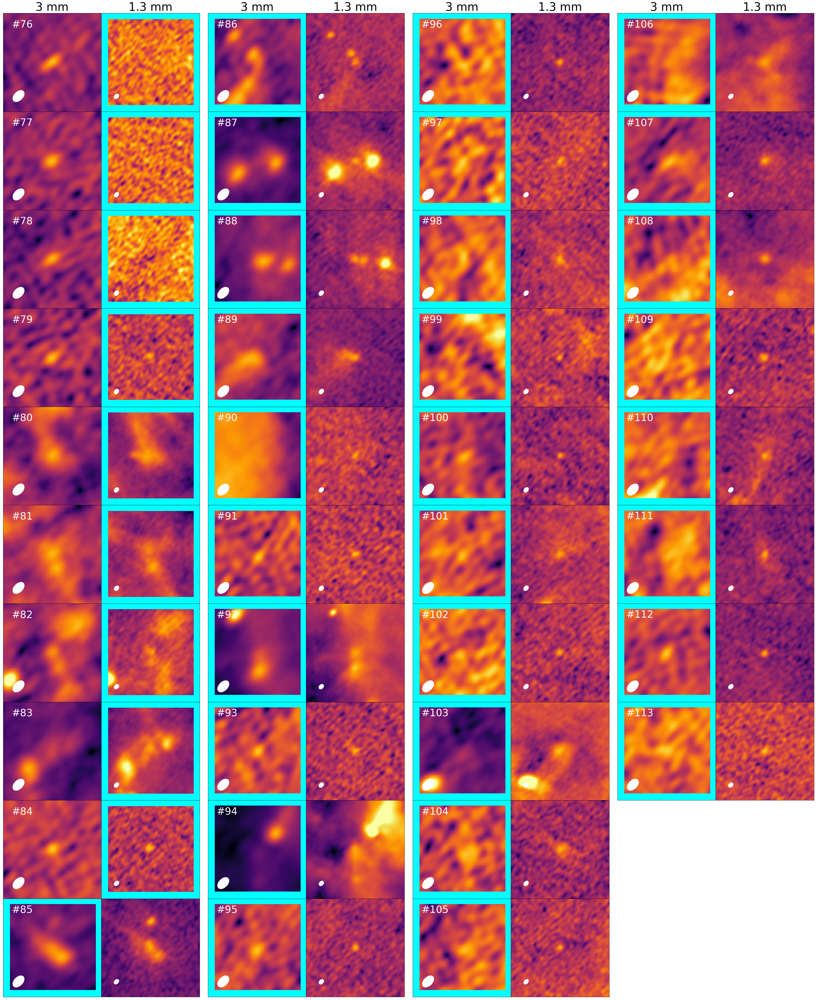

In [19]:
plot_set_cutouts(table_w51e, Path.w51e_b3_tt0, Path.w51e_b6_tt0,startnum=76, nrow=10, endnum=113, savedir='w51e_snapshot-3.png')


endnum 113
endendnum 125
height 0.43499999999999994
top_add 0.8899999999999999
bottom_add 0.020000000000000018
margin 0.01
endnum 113
endendnum 125
arr [114 115 116 117 118 119 120 121 122 123 124]
ind, xind, yind 0 0 0
ind, xind, yind 1 1 0
ind, xind, yind 2 2 0
ind, xind, yind 3 3 0
ind, xind, yind 4 4 0
ind, xind, yind 5 5 0
ind, xind, yind 6 6 0
ind, xind, yind 7 7 0
ind, xind, yind 8 0 1
ind, xind, yind 9 1 1
ind, xind, yind 10 2 1
plot saved to  w51e_snapshot-4.png


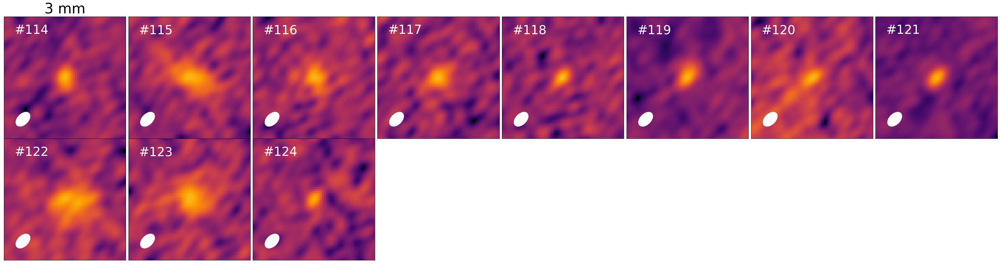

In [18]:
plot_set_cutouts(table_w51e, Path.w51e_b3_tt0, Path.w51e_b6_tt0,startnum=114, ncol=4,nrow=0, endnum=113, additional_row =2,savedir='w51e_snapshot-4.png',top=0.94)


In [8]:
#plot_set_cutouts_single(table_w51e, Path.w51e_b3_tt0, Path.w51e_b6_tt0,startnum=116, nrow=3, ncol=7, savedir='w51e_snapshot-4.png',top = 0.94)


94
obsnum 0
0 290.9146520640484 14.517598602530239 290.9146540877684 14.517602211771774 93059488 226008239
obsnum 1
1 290.9149573660281 14.517820271604664 290.91496053732016 14.517822214455654 93059666 226008505
obsnum 2
2 290.91711257137194 14.517894166260028 290.9171148817953 14.51789666654037 93059791 226008592
obsnum 3
3 290.91819318735975 14.517917495079438 290.9181960716602 14.517921107410602 93059865 226008639
obsnum 4
4 290.9159074232162 14.518008887682536 290.9159051424691 14.518013331336828 93059989 226008773
obsnum 5
5 290.9155097237706 14.518100274957531 290.9155103123461 14.518102218273638 93060140 226008898
obsnum 6
6 290.91586725127314 14.51810027643882 290.9158661182054 14.518103331173297 93060175 226008957
obsnum 7
7 290.9156342557767 14.518109997757158 290.91563541821677 14.51811333007475 93060197 226008977
obsnum 8
8 290.91618259850935 14.518125555073759 290.91618519565134 14.518126665654504 93060212 226008996
obsnum 9
9 290.9159556287268 14.518141110054858 290.91595

10 290.91647986858015 14.518150833273886 290.9164824656977 14.518153333002575 93060233 226009017
obsnum 11
11 290.9168755592578 14.518189722144255 290.9168772955226 14.518191111106656 93060252 226009057
obsnum 12
12 290.91606007491345 14.51816638812409 290.91606008953676 14.518172220811389 93060253 226009062
obsnum 13
13 290.9169378252896 14.518174166525396 290.91694157015155 14.518175555541724 93060278 226009103
obsnum 14
14 290.9155981008108 14.518213053151845 290.91559868926515 14.518217774323498 93060312 226009161
obsnum 15
15 290.9170744089866 14.518234444106799 290.9170758582723 14.518237777687894 93060351 226009198
obsnum 16
16 290.9170021000362 14.51825194422061 290.9170035493046 14.518255555516113 93060347 226009235
obsnum 17
17 290.91660640921447 14.518251944451201 290.916607571536 14.51825555539965 93060398 226009246
obsnum 18
18 290.9170744090439 14.518265555217914 290.9170747105388 14.518268888799978 93060409 226009270
obsnum 19
19 290.9171527437927 14.51827138840296 290.9

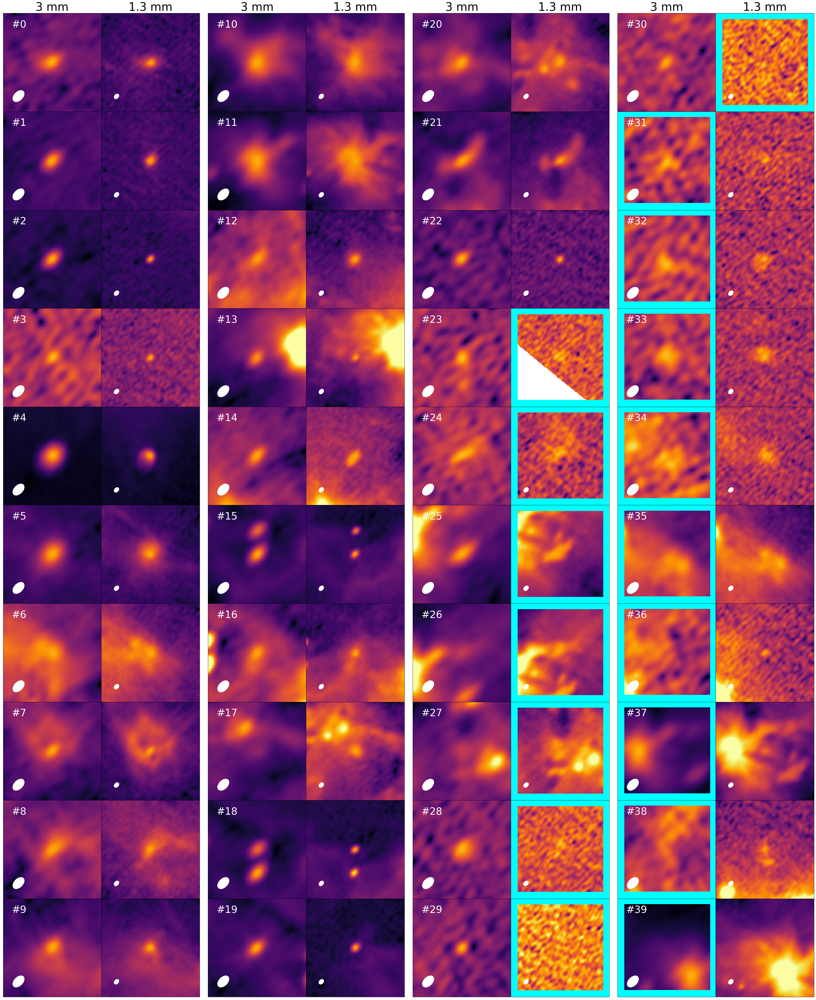

In [9]:
table_w51n = Table.read(Path.w51n_dendro_matched_catalog_new)
print(len(table_w51n))
hdr_b3 = fits.getheader(Path.w51n_b3_tt0)
hdr_b6 = fits.getheader(Path.w51n_b6_tt0)

beam_b3 = Beam.from_fits_header(hdr_b3)    
beam_b6 = Beam.from_fits_header(hdr_b6)    


plot_set_cutouts(table_w51n, Path.w51n_b3_tt0, Path.w51n_b6_tt0, nrow=10, ncol=4,savedir='w51n_snapshot-1.png')


obsnum 40
40 -1.0 -1.0 290.91664544764967 14.51827555543951 -- 226009296
obsnum 41
41 -1.0 -1.0 290.9164962365333 14.519495555247405 -- 226011010
obsnum 42
42 -1.0 -1.0 290.91686811338957 14.519558888884472 -- 226011088
obsnum 43
obsnum_final, endnum 42 42
endnum 42
height 0.10874999999999999
top_add 0.7812499999999999
bottom_add 0.020000000000000018
ind, xind, yind 0 0 0
ind, xind, yind 1 1 0
ind, xind, yind 2 2 0
ind, xind, yind 3 3 0
ind, xind, yind 4 4 0
ind, xind, yind 5 5 0
ind, xind, yind 6 6 0
ind, xind, yind 7 7 0
ind, xind, yind 8 0 1
ind, xind, yind 9 1 1
ind, xind, yind 10 2 1
ind, xind, yind 11 3 1
ind, xind, yind 12 4 1
ind, xind, yind 13 5 1
ind, xind, yind 14 6 1
ind, xind, yind 15 7 1
ind, xind, yind 16 0 2
ind, xind, yind 17 1 2
ind, xind, yind 18 2 2
ind, xind, yind 19 3 2
ind, xind, yind 20 4 2
ind, xind, yind 21 5 2
ind, xind, yind 22 6 2
ind, xind, yind 23 7 2
ind, xind, yind 24 0 3
ind, xind, yind 25 1 3
ind, xind, yind 26 2 3
ind, xind, yind 27 3 3
ind, xind, yi

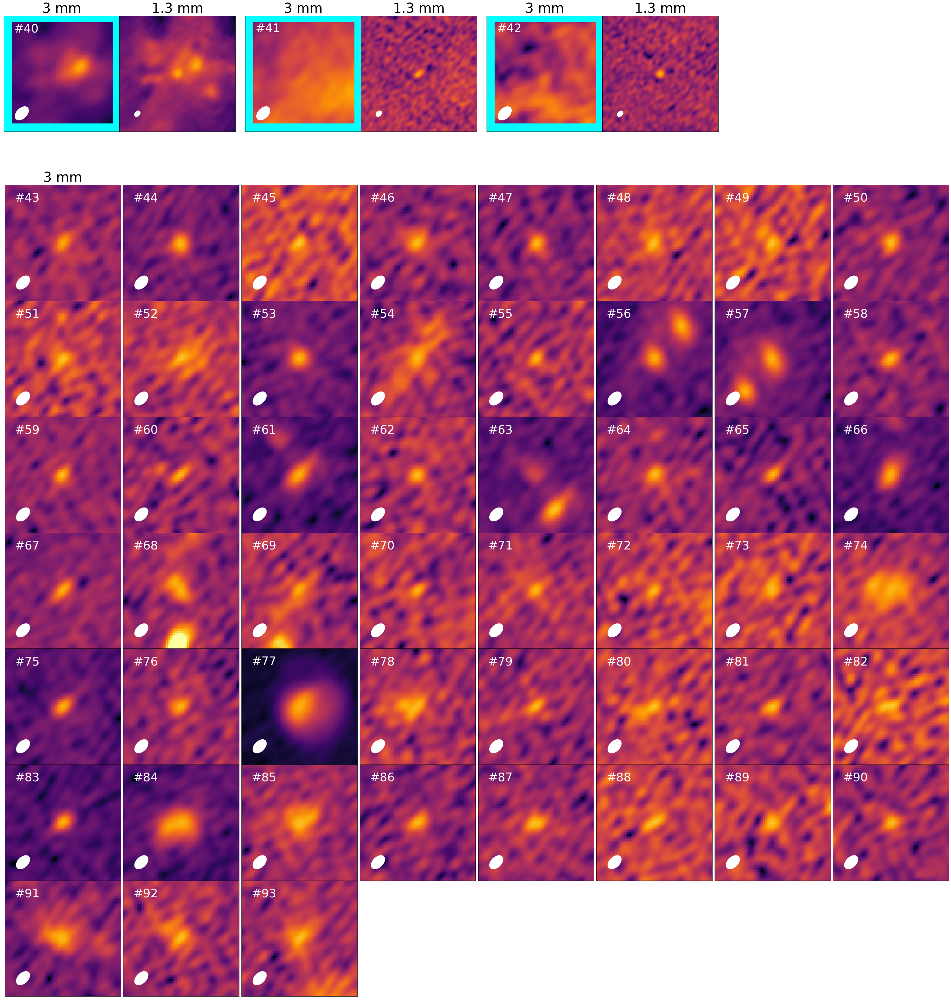

In [10]:
plot_set_cutouts(table_w51n, Path.w51n_b3_tt0, Path.w51n_b6_tt0,startnum=40, nrow=1, ncol=4,additional_row=7, endnum=42,savedir='w51n_snapshot-2.png',top = 0.94)


obsnum 80
80 290.9036290044731 14.517417417808591 -1.0 -1.0 93059269 --
obsnum 81
81 290.92737440273464 14.517855034975975 -1.0 -1.0 93059754 --
obsnum 82
82 290.9048220547021 14.518230258455828 -1.0 -1.0 93060348 --
obsnum 83
83 290.90856605210973 14.518249861045552 -1.0 -1.0 93060378 --
obsnum 84
84 290.90916058161673 14.518574602918118 -1.0 -1.0 93060793 --
obsnum 85
85 290.924919983201 14.519579855757906 -1.0 -1.0 93062022 --
obsnum 86
86 290.91005637782405 14.519681018587862 -1.0 -1.0 93062133 --
obsnum 87
87 290.9274970211586 14.519797529385418 -1.0 -1.0 93062254 --
obsnum 88
88 290.90727446399734 14.519883146532392 -1.0 -1.0 93062355 --
obsnum 89
89 290.9217785762875 14.521118000231056 -1.0 -1.0 93063563 --
obsnum 90
90 290.9217062668108 14.521137446230071 -1.0 -1.0 93063589 --
obsnum 91
91 290.91512402718894 14.525117772770502 -1.0 -1.0 93067307 --
obsnum 92
92 290.91499547379345 14.525131383006777 -1.0 -1.0 93067335 --
obsnum 93
93 290.915164199538 14.52519943969685 -1.0 -1.0 

IndexError: index 94 is out of bounds for axis 0 with size 94

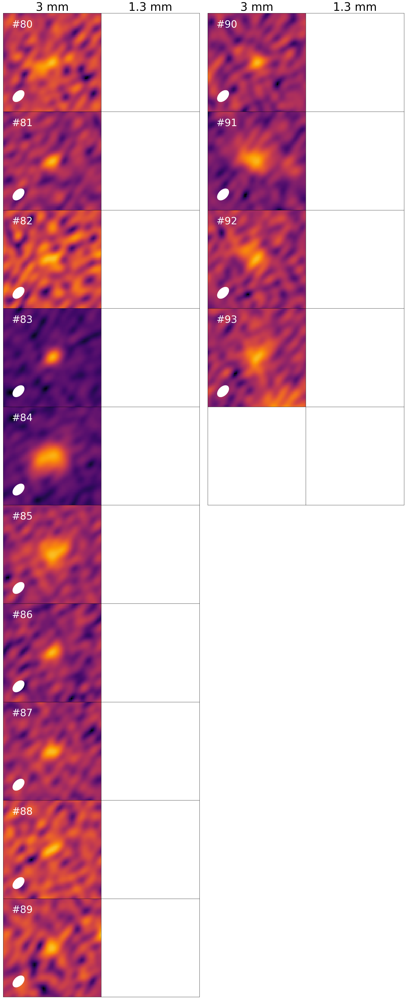

In [11]:
plot_set_cutouts(table_w51n, Path.w51n_b3_tt0, Path.w51n_b6_tt0,startnum=80, nrow=10, ncol=4,savedir='w51n_snapshot-2.png',top = 0.94)


obsnum 40


NameError: name 'xpos_b6' is not defined

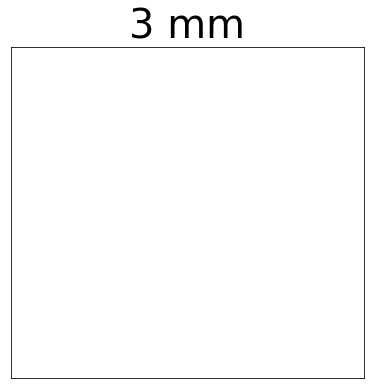